The below cell contains all the constants used in rest of the codes

# Constants

In [1]:
"""
Created on Thu Feb 20 08:22:30 2020

@author: Saba
"""

HOME_DIR = "/home/ubuntu/"


INPUT = HOME_DIR + "Dataset/fields_with_masks/"


BACK_BONE = 'efficientnetb5'
#BACK_BONE = 'vgg16'
BATCH_SIZE = 2
Defined_CLASSES = [1]
LR = 0.0001
EPOCHS = 200

import tensorflow as tf
import os

#from tensorflow.compat.v1 import ConfigProto
#from tensorflow.compat.v1 import InteractiveSession

os.environ['CUDA_VISIBLE_DEVICES'] = '0'
# config = ConfigProto()
# config.gpu_options.allow_growth = True
# session = InteractiveSession(config=config)


config =  tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth=True
sess = tf.compat.v1.Session(config=config)
tf.compat.v1.keras.backend.set_session(sess)

print("TensorFlow version: {}".format(tf.__version__))
print("Eager execution: {}".format(tf.executing_eagerly()))

import keras

OPTIMIZER = keras.optimizers.Adam(LR)
#tf.keras.optimizers.SGD(learning_rate=0.01)


TensorFlow version: 1.15.2
Eager execution: False


Using TensorFlow backend.


# Data_loader and Utility_function cell

In [2]:
import matplotlib.pyplot as plt
from io import BytesIO
import matplotlib.image as mpimg
import numpy as np
import cv2
import os
import re

import tensorflow as tf
import keras
#from tensorflow.keras.backend.tensorflow_backend import set_session  

# os.environ['CUDA_VISIBLE_DEVICES'] = '3'
# config =  tf.compat.v1.ConfigProto()
# config.gpu_options.allow_growth=True
# sess = tf.compat.v1.Session(config=config)
#set_session(sess)

""" This function used to visualize the input, predicted mask and ground truth"""
def visualize(save_status, save_path,flight_code,**images ):
    
    n = len(images)
    plt.figure(figsize=(40,40))
    for i, (name , image) in enumerate(images.items()):
        plt.subplot(1, n, i+1)
        plt.xticks([])
        plt.yticks([])
        # plt.title(str(i+1))
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
        
    
    if save_status : 
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig(save_path+flight_code+'.jpg')    
    plt.show()
    
    
def denormalize(x):
    x_max = np.max(x)
    x_min = np.min(x)
    x = (x-x_min) / (x_max - x_min)
    x = x.clip(0,1)
    return x

def sorted_alphanumeric(data):
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [ convert(c) for c in re.split('([0-9]+)', key) ] 
    return sorted(data, key=alphanum_key,reverse=True)    

class Dataset:
    
    CLASSES = Defined_CLASSES
    def __init__(
            self,
            field_dir,
            status, #train,test,validation
            classes = None,
            augmentation = None,
            preprocessing = None
            ):
        """ make a list of image directions  """
        files = ['bounday_mask.png','nutrient_mask.png']#,'ndvi.png','gndvi.png','ndwi.png']
        self.field_dirs = [ids for ids in sorted(os.listdir(field_dir))]
        self.field_fps = [os.path.join(field_dir ,field_id) for field_id in self.field_dirs if len(os.listdir(os.path.join(field_dir ,field_id))) >= 3 ]
        
        train, validate, test = np.split(self.field_fps, [int(.6*len(self.field_fps)), int(.8*len(self.field_fps))])
        print(len(train))
        print(len(validate))
        print(len(test))
        if status == 'train':
            self.field_fps = train
        elif status == 'validate':
            self.field_fps = validate
        elif status == 'test':
            self.field_fps = test
        
        self.field_codes            = []
        self.field_number            = []
        self.field_images            = []
        self.field_nutrient_mask     = []
        self.field_boundary_mask     = []

        for field_path in self.field_fps:
            flight_dirs = sorted_alphanumeric(os.listdir(field_path))
            codes  = []
            number = []
            images = []
            nutrient_mask = []
            boundary_mask = []

            for j in flight_dirs:
                flight_number, flight_code = j.split('_')
                codes.append(flight_code)
                number.append(flight_number)
                images.append(os.path.join(field_path,j,flight_code+'.png'))
                boundary_mask.append(os.path.join(field_path,j,files[0]))
                nutrient_mask.append(os.path.join(field_path,j,files[1]))


            self.field_codes.append(codes)
            self.field_number.append(number)
            self.field_images.append(images)
            self.field_nutrient_mask.append(nutrient_mask)
            self.field_boundary_mask.append(boundary_mask)

        
        """ set the class values and assign a augmentation and preprocessing method"""
        # self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
        self.class_values = classes
        self.augmentation = augmentation
        self.preprocessing = preprocessing
        
    def __getitem__(self,i):
         
        """ read images"""
        image1 = cv2.imread(self.field_images[i][0])
        image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)
        w, h,_ = image1.shape
        
        
        
        image2 = cv2.imread(self.field_images[i][1])
        image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
        image2 = cv2.resize(image2, (h,w) , interpolation = cv2.INTER_AREA)
        
        
        image3 = cv2.imread(self.field_images[i][2])
        image3 = cv2.cvtColor(image3, cv2.COLOR_BGR2RGB)
        image3 = cv2.resize(image3, (h,w), interpolation = cv2.INTER_AREA)
        
        
        boundary_mask = cv2.imread(self.field_boundary_mask[i][0])
        boundary_mask = cv2.cvtColor(boundary_mask, cv2.COLOR_BGR2GRAY)
        
        
        nutrient_mask = cv2.imread(self.field_nutrient_mask[i][0])
        nutrient_mask = cv2.cvtColor(nutrient_mask, cv2.COLOR_BGR2GRAY) 
        
        boundary_mask = denormalize(boundary_mask)
        nutrient_mask = denormalize(nutrient_mask)

#         image1 = (image1*boundary_mask).astype(np.uint8) 
#         image2 = (image2*boundary_mask).astype(np.uint8) 
#         image3 = (image3*boundary_mask).astype(np.uint8) 
        
        """ extract certain classes from mask 1 """
        masks = [(boundary_mask == v) for v in self.class_values]
        boundary_mask = np.stack(masks, axis = -1).astype('float')
        
        boundary_mask_for_slic = np.stack(masks, axis = 0).astype('float')
        
        masks = [(nutrient_mask == v) for v in self.class_values]
        nutrient_mask = np.stack(masks, axis = -1).astype('float')
        
        data1 = {"image": image1,"image2": image2, "image3": image3, "mask": nutrient_mask }
        """ apply augmentation """
        if self.augmentation:
            sample = self.augmentation(**data1)
            image1 , nutrient_mask, image2, image3 = sample['image'], sample['mask'], sample['image2'], sample['image3'] 
         
        data2 = {"image": image1,"image2": image2, "image3": image3, "mask": nutrient_mask }
        """ apply preprocessing """
        if self.preprocessing:
            sample = self.preprocessing(**data2)
            image1 , nutrient_mask,image2,image3 = sample['image'], sample['mask'], sample['image2'],sample['image3']
        #A1, labels1,X1,y1 = super_pixels(image=image1, mask=boundary_mask_for_slic1, nutrient_mask=nutrient_mask1, prev_labels = None)
        #A2, labels2,X2,y2 = super_pixels(image=image2, mask=boundary_mask_for_slic2, nutrient_mask=nutrient_mask2, prev_labels = labels1)
             
        #return image, nutrient_mask, self.image_dirs[i]
        return image1, image2, image3,nutrient_mask, boundary_mask,self.field_codes[i][0] 
    
    def __len__(self):
        return len(self.field_images)
class Dataloader(keras.utils.Sequence):
    
    def __init__(
            self,
            dataset,
            batch_size = 1,
            shuffle = False
            ):
        
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))
        
        self.on_epoch_end()
        
    def __getitem__(self, i):
        
        start = i * self.batch_size
        stop = (i+1) * self.batch_size
        data1 = []
        data2 = []
        data3 = []
        masks = []
        for j in range(start, stop):
            #data.append([self.dataset[j][0],self.dataset[j][0]],self.dataset[j][1])
            im1,im2,im3,mask,_,_ = self.dataset[j]
#             image_tot = np.concatenate((im1,im2,im3),axis =2)
            #data.append((im1,im2,im3,mask))
            data1.append(im1)
            data2.append(im2)
            data3.append(im3)
            masks.append(mask)
            
        #batch = [np.stack(samples, axis = 0) for samples in zip(*data)]

        return [np.array(data1),np.array(data2),np.array(data3)],[np.array(masks),np.array(masks),np.array(masks)]
    
    def __len__(self):
        """  the number of batches per epoch"""
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)            

# Do Data Augmentation

In [3]:
import albumentations as A


def round_clip_0_1(x, **kwargs):
    return x.round

def training_augmentation():
        train_transform = [
            A.HorizontalFlip(p = 0.5),
            A.VerticalFlip(p=0.5),
            A.ShiftScaleRotate(scale_limit = 0.5, rotate_limit=0, shift_limit = 0.1, p = 1, border_mode=0),
            A.PadIfNeeded(min_height = 512, min_width = 512, always_apply= True, border_mode=0),
            #A.RandomCrop(height=512, width=512, always_apply = True),
            A.CropNonEmptyMaskIfExists(height=512, width=512,always_apply = True),
            #A.RandomResizedCrop(height, width, scale=(0.08, 1.0), ratio=(0.75, 1.3333333333333333), interpolation=1, always_apply=False, p=1.0)
            #A.Resize(height=672, width=672, interpolation=1, always_apply=True, p=1),
            A.IAAAdditiveGaussianNoise(p=0.2),
            A.IAAPerspective(p=0.5),

            A.OneOf(
               [
                   A.CLAHE(p=1),
                   A.RandomBrightness(p=1),
                   A.RandomGamma(p=1),
               ],
               p=0.9,
            ),

            A.OneOf(
               [
                   A.IAASharpen(p=1),
                   A.Blur(blur_limit=3, p=1),
                   A.MotionBlur(blur_limit=3, p=1),
               ],
               p=0.9,
            ),

            A.OneOf(
               [
                   A.RandomContrast(p=1),
                   A.HueSaturationValue(p=1),
               ],
               p=0.9,
           ),
            # A.Lambda(mask = round_clip_0_1)
            #A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), num_shadows_lower=1, num_shadows_upper=2, shadow_dimension=5, always_apply=False, p=0.5)
        ]
    
        return A.Compose(train_transform,
            additional_targets={"image2" : "image", "image3":"image"})

def validation_augmentation():
    test_transform = [
        A.PadIfNeeded(min_height = 512, min_width = 512, always_apply= True, border_mode=0),
        A.CropNonEmptyMaskIfExists(height=512, width=512, always_apply=True)
        #A.RandomCrop(height=512, width=512, always_apply = True)
        #A.Resize(height=1024, width=1024, interpolation=1, always_apply=True, p=1)
        ]
    return A.Compose(test_transform,additional_targets={"image2" : "image", "image3":"image"})

def get_preprocessing(preprocessing_fn):
    
    _transform = [
        A.Lambda(image = preprocessing_fn),
        ]
    return A.Compose(_transform,additional_targets={"image2" : "image", "image3":"image"})

# BASE_MODEL

In [4]:
import segmentation_models as sm
import numpy as np
import keras
import matplotlib.pyplot as plt
from keras.models import Model
from keras.layers import Input, Conv2D, Concatenate, Multiply

""" define preprocess method condisering back_bone"""
preprocess_input = sm.get_preprocessing(BACK_BONE)
""" model parameters"""
n_classes = 1 if len(Defined_CLASSES)== 1 else (len(Defined_CLASSES)+1)
activation = 'sigmoid' if n_classes == 1 else 'softmax'

model_1 = sm.Unet(BACK_BONE, classes = n_classes, activation = activation,input_shape=(None, None, 3), encoder_weights='imagenet',encoder_freeze = True)

model_2 = sm.Unet(BACK_BONE, classes = n_classes, activation = activation,input_shape=(None, None, 3), encoder_weights='imagenet',encoder_freeze = True)
# inp = Input(shape=(None, None, 4))
# l1 = Conv2D(3, (1, 1))(inp) # map N channels data to 3 channels
# out = model_2(l1)
# model_2 = keras.models.Model(inp, out, name=model_2.name)

model_3 = sm.Unet(BACK_BONE, classes = n_classes, activation = activation,input_shape=(None, None, 3), encoder_weights='imagenet',encoder_freeze = True)
# inp = Input(shape=(None, None, 4))
# l1 = Conv2D(3, (1, 1))(inp) # map N channels data to 3 channels
# out = model_3(l1)
# model_3 = keras.models.Model(inp, out, name=model_3.name)


"""creating a model"""
def my_model(model_1,model_2,model_3):
    input_1 = Input(shape=(512,512,3), name='input_1')
    input_2 = Input(shape=(512,512,3), name='input_2')
    input_3 = Input(shape=(512,512,3), name='input_3')
    
#     zero = tf.keras.backend.zeros((None,512,512,1))
#     input_3_new =Concatenate(axis=3)([zero, input_3])
    
    x3 = Model(model_1.input, model_1.output, name='model_3')(input_3)
    p = Concatenate(axis=3)([x3,x3,x3])
    
    input_2_new =Concatenate(axis=3)([x3, input_2])
    input_2_new = Conv2D(3, (1, 1))(input_2_new)
    x2 = Model(model_2.input, model_2.output, name='model_2')(input_2_new)
    p = Concatenate(axis=3)([x2,x2,x2])
    
    input_1_new =Concatenate(axis=3)([x2, input_1])
    input_1_new = Conv2D(3, (1, 1))(input_1_new)
    x1 = Model(model_3.input, model_3.output , name='model_1')(input_1_new)
    
    final_model = Model(inputs =[input_1,input_2,input_3],outputs=[x3,x2,x1])
    
    return final_model

model = my_model(model_1,model_2,model_3)
model.summary()
""" defining loss function and metrics"""
#dice_loss = sm.losses.DiceLoss(class_weights=np.array([0.1,0.3,0.7,0.9])) 
#focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
#total_loss = dice_loss + (1 * focal_loss)
total_loss = sm.losses.binary_focal_dice_loss
losses = {
    "model_3": total_loss,
    "model_2": total_loss,
    "model_1": total_loss,
}
metrics = [sm.metrics.IOUScore(threshold =0.5), sm.metrics.FScore(threshold = 0.5), sm.metrics.Precision(threshold = 0.5),sm.metrics.Recall(threshold = 0.5) ]

""" compiling the network """
model.compile(OPTIMIZER, losses, metrics)



Segmentation Models: using `keras` framework.











Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
model_3 (Model)                 multiple             37468673    input_3[0][0]                    
__________________________________________________________________________________________________
input_2 (InputLayer)            (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
concatenate_2 (Concatenate)     (N

In [5]:
""" loading traind and validation dataset """
train_dataset = Dataset(INPUT,
                        status = 'train',
                           classes = Defined_CLASSES,
                           augmentation = training_augmentation(),
                           preprocessing = get_preprocessing(preprocess_input),
                           )

valid_dataset = Dataset(INPUT,
                        status = 'validate',
                           classes = Defined_CLASSES,
                           augmentation = training_augmentation(),
                           preprocessing = get_preprocessing(preprocess_input),
                           )

train_dataloader = Dataloader(train_dataset, batch_size = BATCH_SIZE, shuffle = True )
valid_dataloader = Dataloader(valid_dataset, batch_size = 1, shuffle = False )
#print(len(train_dataloader),'lklklkl')
# print(valid_dataloader[0][0].size())

231
77
78
231
77
78


Train the MODEL

In [6]:
"""check shapes for errors"""
#assert train_dataloader[0][0].shape == (BATCH_SIZE, 512, 512, 3)
#assert train_dataloader[0][1].shape == (BATCH_SIZE, 512, 512, n_classes)

""" define callbacks  for learning rate scheduling and best checkpoints """

callbacks = [
    keras.callbacks.ModelCheckpoint('/home/ubuntu/Trained_model/Unet_segmentaion_'+BACK_BONE+'_batch_'+str(BATCH_SIZE)+'_epoch_'+str(EPOCHS)+'_3_time_steps_3_3_channel_concat'+'.h5', save_weights_only=True, save_best_only=True, mode='min'),
    keras.callbacks.ReduceLROnPlateau(),
    ]

history = model.fit_generator(
    train_dataloader,
    steps_per_epoch = len(train_dataloader),
    epochs = EPOCHS,
    callbacks = callbacks,
    validation_data=valid_dataloader, 
    validation_steps=len(valid_dataloader),
    )




Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Epoch 1/200
 43/115 [==========>...................] - ETA: 9:21 - loss: 3.1760 - model_3_loss: 1.0664 - model_2_loss: 0.9783 - model_1_loss: 1.1314 - model_3_iou_score: 0.0639 - model_3_f1-score: 0.1140 - model_2_iou_score: 0.0626 - model_2_f1-score: 0.1142 - model_1_iou_score: 0.0769 - model_1_f1-score: 0.1337

/home/ubuntu/anaconda3/envs/tensorflow_p36/lib/python3.6/site-packages/ipykernel/__main__.py:43: RuntimeWarning: invalid value encountered in true_divide


115/115 [==============================] - 413s 4s/step - loss: 2.9777 - model_3_loss: 1.0113 - model_2_loss: 0.9439 - model_1_loss: 1.0226 - model_3_iou_score: 0.0845 - model_3_f1-score: 0.1474 - model_2_iou_score: 0.0824 - model_2_f1-score: 0.1462 - model_1_iou_score: 0.1160 - model_1_f1-score: 0.1957 - val_loss: 3.0787 - val_model_3_loss: 1.0234 - val_model_2_loss: 0.9696 - val_model_1_loss: 1.0856 - val_model_3_iou_score: 0.0749 - val_model_3_f1-score: 0.1226 - val_model_2_iou_score: 0.0796 - val_model_2_f1-score: 0.1317 - val_model_1_iou_score: 0.1252 - val_model_1_f1-score: 0.1953
Epoch 2/200
115/115 [==============================] - 77s 667ms/step - loss: 2.7756 - model_3_loss: 0.9518 - model_2_loss: 0.9163 - model_1_loss: 0.9075 - model_3_iou_score: 0.0918 - model_3_f1-score: 0.1604 - model_2_iou_score: 0.0969 - model_2_f1-score: 0.1697 - model_1_iou_score: 0.1825 - model_1_f1-score: 0.2913 - val_loss: 2.8510 - val_model_3_loss: 0.9645 - val_model_2_loss: 0.9399 - val_model_1_

115/115 [==============================] - 77s 666ms/step - loss: 2.3875 - model_3_loss: 0.8406 - model_2_loss: 0.8104 - model_1_loss: 0.7365 - model_3_iou_score: 0.1619 - model_3_f1-score: 0.2649 - model_2_iou_score: 0.1886 - model_2_f1-score: 0.3015 - model_1_iou_score: 0.2500 - model_1_f1-score: 0.3837 - val_loss: 2.6826 - val_model_3_loss: 0.9292 - val_model_2_loss: 0.8894 - val_model_1_loss: 0.8641 - val_model_3_iou_score: 0.0761 - val_model_3_f1-score: 0.1218 - val_model_2_iou_score: 0.1336 - val_model_2_f1-score: 0.2046 - val_model_1_iou_score: 0.1498 - val_model_1_f1-score: 0.2260
Epoch 15/200
115/115 [==============================] - 77s 666ms/step - loss: 2.3986 - model_3_loss: 0.8437 - model_2_loss: 0.8075 - model_1_loss: 0.7474 - model_3_iou_score: 0.1619 - model_3_f1-score: 0.2645 - model_2_iou_score: 0.1953 - model_2_f1-score: 0.3100 - model_1_iou_score: 0.2431 - model_1_f1-score: 0.3702 - val_loss: 2.6473 - val_model_3_loss: 0.9077 - val_model_2_loss: 0.8984 - val_model

115/115 [==============================] - 77s 669ms/step - loss: 2.3537 - model_3_loss: 0.8342 - model_2_loss: 0.8005 - model_1_loss: 0.7189 - model_3_iou_score: 0.1629 - model_3_f1-score: 0.2629 - model_2_iou_score: 0.1940 - model_2_f1-score: 0.3073 - model_1_iou_score: 0.2583 - model_1_f1-score: 0.3936 - val_loss: 2.5825 - val_model_3_loss: 0.9125 - val_model_2_loss: 0.8848 - val_model_1_loss: 0.7851 - val_model_3_iou_score: 0.1049 - val_model_3_f1-score: 0.1676 - val_model_2_iou_score: 0.1485 - val_model_2_f1-score: 0.2210 - val_model_1_iou_score: 0.2219 - val_model_1_f1-score: 0.3267
Epoch 28/200
115/115 [==============================] - 77s 670ms/step - loss: 2.3403 - model_3_loss: 0.8252 - model_2_loss: 0.7956 - model_1_loss: 0.7195 - model_3_iou_score: 0.1745 - model_3_f1-score: 0.2808 - model_2_iou_score: 0.1984 - model_2_f1-score: 0.3141 - model_1_iou_score: 0.2595 - model_1_f1-score: 0.3919 - val_loss: 2.6169 - val_model_3_loss: 0.9221 - val_model_2_loss: 0.8874 - val_model

115/115 [==============================] - 77s 667ms/step - loss: 2.2869 - model_3_loss: 0.8174 - model_2_loss: 0.7832 - model_1_loss: 0.6863 - model_3_iou_score: 0.1762 - model_3_f1-score: 0.2835 - model_2_iou_score: 0.2081 - model_2_f1-score: 0.3274 - model_1_iou_score: 0.2809 - model_1_f1-score: 0.4208 - val_loss: 2.5504 - val_model_3_loss: 0.9070 - val_model_2_loss: 0.8738 - val_model_1_loss: 0.7696 - val_model_3_iou_score: 0.1065 - val_model_3_f1-score: 0.1631 - val_model_2_iou_score: 0.1260 - val_model_2_f1-score: 0.1977 - val_model_1_iou_score: 0.2304 - val_model_1_f1-score: 0.3381
Epoch 41/200
115/115 [==============================] - 77s 666ms/step - loss: 2.2866 - model_3_loss: 0.8168 - model_2_loss: 0.7842 - model_1_loss: 0.6856 - model_3_iou_score: 0.1765 - model_3_f1-score: 0.2834 - model_2_iou_score: 0.2045 - model_2_f1-score: 0.3236 - model_1_iou_score: 0.2805 - model_1_f1-score: 0.4221 - val_loss: 2.4702 - val_model_3_loss: 0.8833 - val_model_2_loss: 0.8538 - val_model

115/115 [==============================] - 76s 663ms/step - loss: 2.2789 - model_3_loss: 0.8164 - model_2_loss: 0.7741 - model_1_loss: 0.6883 - model_3_iou_score: 0.1791 - model_3_f1-score: 0.2858 - model_2_iou_score: 0.2115 - model_2_f1-score: 0.3316 - model_1_iou_score: 0.2747 - model_1_f1-score: 0.4129 - val_loss: 2.5451 - val_model_3_loss: 0.9112 - val_model_2_loss: 0.8674 - val_model_1_loss: 0.7665 - val_model_3_iou_score: 0.0904 - val_model_3_f1-score: 0.1424 - val_model_2_iou_score: 0.1371 - val_model_2_f1-score: 0.2119 - val_model_1_iou_score: 0.2286 - val_model_1_f1-score: 0.3427
Epoch 54/200
115/115 [==============================] - 77s 667ms/step - loss: 2.2846 - model_3_loss: 0.8135 - model_2_loss: 0.7824 - model_1_loss: 0.6887 - model_3_iou_score: 0.1798 - model_3_f1-score: 0.2901 - model_2_iou_score: 0.2037 - model_2_f1-score: 0.3239 - model_1_iou_score: 0.2747 - model_1_f1-score: 0.4146 - val_loss: 2.5531 - val_model_3_loss: 0.9171 - val_model_2_loss: 0.8702 - val_model

115/115 [==============================] - 77s 669ms/step - loss: 2.2663 - model_3_loss: 0.8120 - model_2_loss: 0.7796 - model_1_loss: 0.6747 - model_3_iou_score: 0.1847 - model_3_f1-score: 0.2982 - model_2_iou_score: 0.2096 - model_2_f1-score: 0.3335 - model_1_iou_score: 0.2911 - model_1_f1-score: 0.4322 - val_loss: 2.5355 - val_model_3_loss: 0.9071 - val_model_2_loss: 0.8697 - val_model_1_loss: 0.7587 - val_model_3_iou_score: 0.1019 - val_model_3_f1-score: 0.1606 - val_model_2_iou_score: 0.1368 - val_model_2_f1-score: 0.2134 - val_model_1_iou_score: 0.2288 - val_model_1_f1-score: 0.3383
Epoch 67/200
115/115 [==============================] - 77s 668ms/step - loss: 2.2606 - model_3_loss: 0.8148 - model_2_loss: 0.7725 - model_1_loss: 0.6734 - model_3_iou_score: 0.1752 - model_3_f1-score: 0.2815 - model_2_iou_score: 0.2127 - model_2_f1-score: 0.3347 - model_1_iou_score: 0.2887 - model_1_f1-score: 0.4310 - val_loss: 2.5792 - val_model_3_loss: 0.9216 - val_model_2_loss: 0.8922 - val_model

115/115 [==============================] - 76s 665ms/step - loss: 2.2653 - model_3_loss: 0.8088 - model_2_loss: 0.7760 - model_1_loss: 0.6806 - model_3_iou_score: 0.1849 - model_3_f1-score: 0.2964 - model_2_iou_score: 0.2097 - model_2_f1-score: 0.3317 - model_1_iou_score: 0.2860 - model_1_f1-score: 0.4287 - val_loss: 2.5162 - val_model_3_loss: 0.9025 - val_model_2_loss: 0.8580 - val_model_1_loss: 0.7557 - val_model_3_iou_score: 0.1080 - val_model_3_f1-score: 0.1649 - val_model_2_iou_score: 0.1442 - val_model_2_f1-score: 0.2172 - val_model_1_iou_score: 0.2398 - val_model_1_f1-score: 0.3449
Epoch 80/200
115/115 [==============================] - 77s 667ms/step - loss: 2.2837 - model_3_loss: 0.8206 - model_2_loss: 0.7776 - model_1_loss: 0.6855 - model_3_iou_score: 0.1787 - model_3_f1-score: 0.2846 - model_2_iou_score: 0.2085 - model_2_f1-score: 0.3282 - model_1_iou_score: 0.2779 - model_1_f1-score: 0.4165 - val_loss: 2.4834 - val_model_3_loss: 0.8885 - val_model_2_loss: 0.8496 - val_model

115/115 [==============================] - 76s 664ms/step - loss: 2.2962 - model_3_loss: 0.8151 - model_2_loss: 0.7852 - model_1_loss: 0.6959 - model_3_iou_score: 0.1750 - model_3_f1-score: 0.2799 - model_2_iou_score: 0.2024 - model_2_f1-score: 0.3207 - model_1_iou_score: 0.2732 - model_1_f1-score: 0.4116 - val_loss: 2.5448 - val_model_3_loss: 0.9014 - val_model_2_loss: 0.8756 - val_model_1_loss: 0.7678 - val_model_3_iou_score: 0.1068 - val_model_3_f1-score: 0.1643 - val_model_2_iou_score: 0.1359 - val_model_2_f1-score: 0.2120 - val_model_1_iou_score: 0.2200 - val_model_1_f1-score: 0.3296
Epoch 93/200
115/115 [==============================] - 76s 665ms/step - loss: 2.2825 - model_3_loss: 0.8123 - model_2_loss: 0.7833 - model_1_loss: 0.6869 - model_3_iou_score: 0.1812 - model_3_f1-score: 0.2892 - model_2_iou_score: 0.2065 - model_2_f1-score: 0.3255 - model_1_iou_score: 0.2805 - model_1_f1-score: 0.4198 - val_loss: 2.6019 - val_model_3_loss: 0.9194 - val_model_2_loss: 0.8900 - val_model

115/115 [==============================] - 77s 666ms/step - loss: 2.2351 - model_3_loss: 0.8096 - model_2_loss: 0.7665 - model_1_loss: 0.6590 - model_3_iou_score: 0.1902 - model_3_f1-score: 0.3033 - model_2_iou_score: 0.2235 - model_2_f1-score: 0.3499 - model_1_iou_score: 0.3018 - model_1_f1-score: 0.4468 - val_loss: 2.5187 - val_model_3_loss: 0.8922 - val_model_2_loss: 0.8634 - val_model_1_loss: 0.7632 - val_model_3_iou_score: 0.1125 - val_model_3_f1-score: 0.1705 - val_model_2_iou_score: 0.1435 - val_model_2_f1-score: 0.2171 - val_model_1_iou_score: 0.2280 - val_model_1_f1-score: 0.3350
Epoch 106/200
115/115 [==============================] - 77s 667ms/step - loss: 2.2899 - model_3_loss: 0.8192 - model_2_loss: 0.7858 - model_1_loss: 0.6849 - model_3_iou_score: 0.1699 - model_3_f1-score: 0.2761 - model_2_iou_score: 0.2027 - model_2_f1-score: 0.3218 - model_1_iou_score: 0.2809 - model_1_f1-score: 0.4223 - val_loss: 2.5447 - val_model_3_loss: 0.8983 - val_model_2_loss: 0.8669 - val_mode

115/115 [==============================] - 76s 664ms/step - loss: 2.2911 - model_3_loss: 0.8186 - model_2_loss: 0.7845 - model_1_loss: 0.6880 - model_3_iou_score: 0.1772 - model_3_f1-score: 0.2859 - model_2_iou_score: 0.2031 - model_2_f1-score: 0.3224 - model_1_iou_score: 0.2767 - model_1_f1-score: 0.4154 - val_loss: 2.4626 - val_model_3_loss: 0.8803 - val_model_2_loss: 0.8453 - val_model_1_loss: 0.7370 - val_model_3_iou_score: 0.1226 - val_model_3_f1-score: 0.1857 - val_model_2_iou_score: 0.1507 - val_model_2_f1-score: 0.2307 - val_model_1_iou_score: 0.2550 - val_model_1_f1-score: 0.3668
Epoch 119/200
115/115 [==============================] - 77s 665ms/step - loss: 2.2354 - model_3_loss: 0.8046 - model_2_loss: 0.7639 - model_1_loss: 0.6670 - model_3_iou_score: 0.1876 - model_3_f1-score: 0.2995 - model_2_iou_score: 0.2196 - model_2_f1-score: 0.3430 - model_1_iou_score: 0.2974 - model_1_f1-score: 0.4366 - val_loss: 2.4753 - val_model_3_loss: 0.8759 - val_model_2_loss: 0.8396 - val_mode

115/115 [==============================] - 78s 676ms/step - loss: 2.3082 - model_3_loss: 0.8232 - model_2_loss: 0.7902 - model_1_loss: 0.6947 - model_3_iou_score: 0.1742 - model_3_f1-score: 0.2793 - model_2_iou_score: 0.2047 - model_2_f1-score: 0.3223 - model_1_iou_score: 0.2762 - model_1_f1-score: 0.4127 - val_loss: 2.5691 - val_model_3_loss: 0.9221 - val_model_2_loss: 0.8742 - val_model_1_loss: 0.7728 - val_model_3_iou_score: 0.0868 - val_model_3_f1-score: 0.1398 - val_model_2_iou_score: 0.1382 - val_model_2_f1-score: 0.2170 - val_model_1_iou_score: 0.2185 - val_model_1_f1-score: 0.3283
Epoch 132/200
115/115 [==============================] - 78s 681ms/step - loss: 2.2634 - model_3_loss: 0.8112 - model_2_loss: 0.7753 - model_1_loss: 0.6769 - model_3_iou_score: 0.1853 - model_3_f1-score: 0.2968 - model_2_iou_score: 0.2147 - model_2_f1-score: 0.3378 - model_1_iou_score: 0.2929 - model_1_f1-score: 0.4358 - val_loss: 2.5654 - val_model_3_loss: 0.9112 - val_model_2_loss: 0.8729 - val_mode

115/115 [==============================] - 78s 682ms/step - loss: 2.2644 - model_3_loss: 0.8148 - model_2_loss: 0.7765 - model_1_loss: 0.6731 - model_3_iou_score: 0.1811 - model_3_f1-score: 0.2896 - model_2_iou_score: 0.2140 - model_2_f1-score: 0.3358 - model_1_iou_score: 0.2914 - model_1_f1-score: 0.4329 - val_loss: 2.4974 - val_model_3_loss: 0.8913 - val_model_2_loss: 0.8655 - val_model_1_loss: 0.7406 - val_model_3_iou_score: 0.1156 - val_model_3_f1-score: 0.1829 - val_model_2_iou_score: 0.1432 - val_model_2_f1-score: 0.2246 - val_model_1_iou_score: 0.2595 - val_model_1_f1-score: 0.3724
Epoch 145/200
115/115 [==============================] - 78s 679ms/step - loss: 2.3046 - model_3_loss: 0.8211 - model_2_loss: 0.7890 - model_1_loss: 0.6945 - model_3_iou_score: 0.1788 - model_3_f1-score: 0.2877 - model_2_iou_score: 0.2042 - model_2_f1-score: 0.3223 - model_1_iou_score: 0.2752 - model_1_f1-score: 0.4127 - val_loss: 2.5352 - val_model_3_loss: 0.9087 - val_model_2_loss: 0.8598 - val_mode

115/115 [==============================] - 79s 686ms/step - loss: 2.2380 - model_3_loss: 0.8025 - model_2_loss: 0.7703 - model_1_loss: 0.6652 - model_3_iou_score: 0.1863 - model_3_f1-score: 0.2981 - model_2_iou_score: 0.2144 - model_2_f1-score: 0.3371 - model_1_iou_score: 0.2927 - model_1_f1-score: 0.4376 - val_loss: 2.5119 - val_model_3_loss: 0.8999 - val_model_2_loss: 0.8573 - val_model_1_loss: 0.7546 - val_model_3_iou_score: 0.1049 - val_model_3_f1-score: 0.1669 - val_model_2_iou_score: 0.1402 - val_model_2_f1-score: 0.2203 - val_model_1_iou_score: 0.2259 - val_model_1_f1-score: 0.3297
Epoch 158/200
115/115 [==============================] - 78s 681ms/step - loss: 2.2832 - model_3_loss: 0.8240 - model_2_loss: 0.7801 - model_1_loss: 0.6792 - model_3_iou_score: 0.1736 - model_3_f1-score: 0.2806 - model_2_iou_score: 0.2119 - model_2_f1-score: 0.3325 - model_1_iou_score: 0.2868 - model_1_f1-score: 0.4267 - val_loss: 2.5876 - val_model_3_loss: 0.9173 - val_model_2_loss: 0.8868 - val_mode

115/115 [==============================] - 79s 683ms/step - loss: 2.2278 - model_3_loss: 0.8068 - model_2_loss: 0.7618 - model_1_loss: 0.6592 - model_3_iou_score: 0.1848 - model_3_f1-score: 0.2949 - model_2_iou_score: 0.2213 - model_2_f1-score: 0.3452 - model_1_iou_score: 0.2965 - model_1_f1-score: 0.4396 - val_loss: 2.4338 - val_model_3_loss: 0.8686 - val_model_2_loss: 0.8298 - val_model_1_loss: 0.7354 - val_model_3_iou_score: 0.1277 - val_model_3_f1-score: 0.1971 - val_model_2_iou_score: 0.1733 - val_model_2_f1-score: 0.2631 - val_model_1_iou_score: 0.2612 - val_model_1_f1-score: 0.3750
Epoch 171/200
115/115 [==============================] - 79s 685ms/step - loss: 2.2385 - model_3_loss: 0.8087 - model_2_loss: 0.7678 - model_1_loss: 0.6620 - model_3_iou_score: 0.1821 - model_3_f1-score: 0.2916 - model_2_iou_score: 0.2174 - model_2_f1-score: 0.3420 - model_1_iou_score: 0.3000 - model_1_f1-score: 0.4450 - val_loss: 2.5220 - val_model_3_loss: 0.9059 - val_model_2_loss: 0.8656 - val_mode

115/115 [==============================] - 79s 685ms/step - loss: 2.2274 - model_3_loss: 0.8034 - model_2_loss: 0.7635 - model_1_loss: 0.6605 - model_3_iou_score: 0.1879 - model_3_f1-score: 0.2999 - model_2_iou_score: 0.2214 - model_2_f1-score: 0.3466 - model_1_iou_score: 0.2986 - model_1_f1-score: 0.4421 - val_loss: 2.5006 - val_model_3_loss: 0.8920 - val_model_2_loss: 0.8615 - val_model_1_loss: 0.7471 - val_model_3_iou_score: 0.1210 - val_model_3_f1-score: 0.1891 - val_model_2_iou_score: 0.1421 - val_model_2_f1-score: 0.2208 - val_model_1_iou_score: 0.2428 - val_model_1_f1-score: 0.3564
Epoch 184/200
115/115 [==============================] - 78s 682ms/step - loss: 2.2293 - model_3_loss: 0.7990 - model_2_loss: 0.7636 - model_1_loss: 0.6667 - model_3_iou_score: 0.1895 - model_3_f1-score: 0.3026 - model_2_iou_score: 0.2179 - model_2_f1-score: 0.3447 - model_1_iou_score: 0.2951 - model_1_f1-score: 0.4400 - val_loss: 2.4950 - val_model_3_loss: 0.8895 - val_model_2_loss: 0.8526 - val_mode

115/115 [==============================] - 79s 683ms/step - loss: 2.2774 - model_3_loss: 0.8110 - model_2_loss: 0.7770 - model_1_loss: 0.6894 - model_3_iou_score: 0.1817 - model_3_f1-score: 0.2929 - model_2_iou_score: 0.2117 - model_2_f1-score: 0.3354 - model_1_iou_score: 0.2757 - model_1_f1-score: 0.4148 - val_loss: 2.5026 - val_model_3_loss: 0.8913 - val_model_2_loss: 0.8547 - val_model_1_loss: 0.7566 - val_model_3_iou_score: 0.1108 - val_model_3_f1-score: 0.1699 - val_model_2_iou_score: 0.1484 - val_model_2_f1-score: 0.2254 - val_model_1_iou_score: 0.2425 - val_model_1_f1-score: 0.3525
Epoch 197/200
115/115 [==============================] - 79s 683ms/step - loss: 2.2416 - model_3_loss: 0.8087 - model_2_loss: 0.7719 - model_1_loss: 0.6610 - model_3_iou_score: 0.1862 - model_3_f1-score: 0.2976 - model_2_iou_score: 0.2203 - model_2_f1-score: 0.3438 - model_1_iou_score: 0.3083 - model_1_f1-score: 0.4489 - val_loss: 2.5138 - val_model_3_loss: 0.8991 - val_model_2_loss: 0.8569 - val_mode

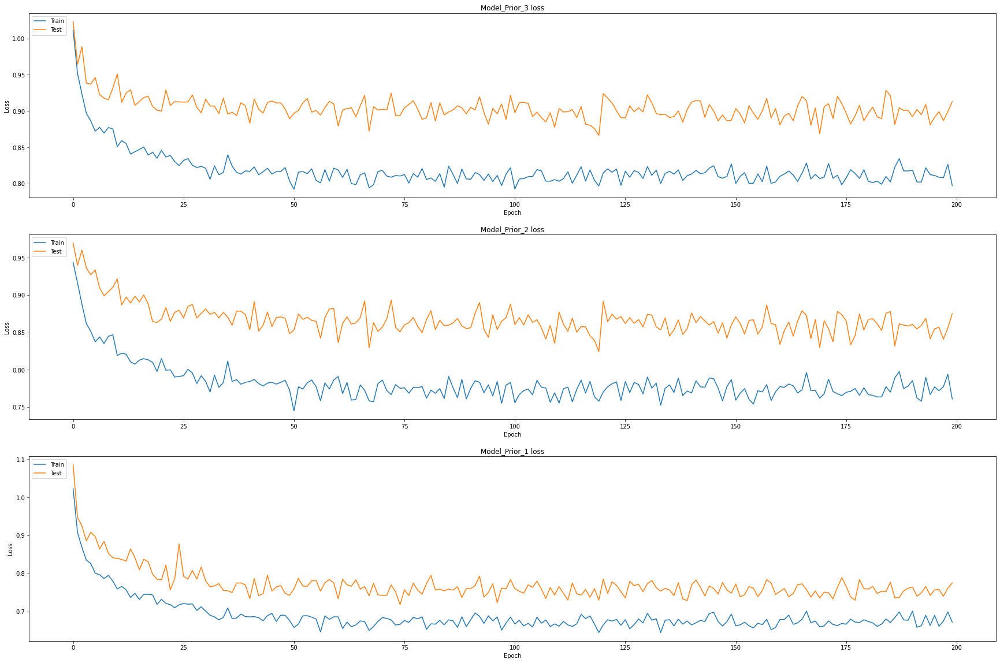

In [7]:

plt.figure(figsize=(30, 20))
plt.subplot(311)
plt.plot(history.history['model_3_loss'])
plt.plot(history.history['val_model_3_loss'])
plt.title('Model_Prior_3 loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.subplot(312)
plt.plot(history.history['model_2_loss'])
plt.plot(history.history['val_model_2_loss'])
plt.title('Model_Prior_2 loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.subplot(313)
plt.plot(history.history['model_1_loss'])
plt.plot(history.history['val_model_1_loss'])
plt.title('Model_Prior_1 loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
# plt.show()
plt.savefig('training_loss_IOU_'+BACK_BONE+'_batch_'+str(BATCH_SIZE)+'_epoch_'+str(EPOCHS)+'_3_time_steps_3_3_channel'+'.png')

In [ ]:
""" MOdel Evaluation """
from keras.models import load_model
test_dataset = Dataset(INPUT,
                       status = 'test',
                classes = Defined_CLASSES,
                augmentation = validation_augmentation(),
                preprocessing = get_preprocessing(preprocess_input),
                
    )

test_dataloader = Dataloader(test_dataset, batch_size=1, shuffle=False)
# model2 = load_model('/home/ubuntu/Trained_model/Unet_segmentaion_'+BACK_BONE+'_batch_'+str(BATCH_SIZE)+'_epoch_'+str(EPOCHS)+'_3_time_steps_3_3_channel_concat'+'.h5', custom_objects={'iou_score':sm.metrics.IOUScore(threshold =0.5), 'f1-score':sm.metrics.FScore(threshold = 0.5),'dice_loss_plus_1focal_loss':sm.losses.binary_focal_dice_loss })
#model.summary() #= sm.Unet(BACK_BONE, classes = n_classes, activation = activation, encoder_weights='imagenet',encoder_freeze = False)
#model2 =my_model(model_1,model_2,model_3) 
model.load_weights('/home/ubuntu/Trained_model/Unet_segmentaion_'+BACK_BONE+'_batch_'+str(BATCH_SIZE)+'_epoch_'+str(EPOCHS)+'_3_time_steps_3_3_channel_concat'+'.h5')

In [7]:
scores = model.evaluate_generator(test_dataloader)
print('__model_3__:\n')
print("model_3_Loss: {:.5}".format(scores[1]))
print("model_3 mean iou_score: {:.5}".format(scores[4]))
print("model_3 mean f1_score: {:.5}".format(scores[5]))
print("model_3 mean precesion: {:.5}".format(scores[6]))
print("model_3 mean recall: {:.5}".format(scores[7]))
                   
print('__model_2__:\n')                  
print("model_2_Loss: {:.5}".format(scores[2]))                   
print("model_2 mean iou_score: {:.5}".format(scores[8]))
print("model_2 mean f1_score: {:.5}".format(scores[9]))
print("model_2 mean precesion: {:.5}".format(scores[10]))
print("model_2 mean recall: {:.5}".format(scores[11]))

print('__model_1__:\n')
print("model_1_Loss: {:.5}".format(scores[3]))
print("model_1 mean iou_score: {:.5}".format(scores[12]))
print("model_1 mean f1_score: {:.5}".format(scores[13]))
print("model_1 mean precesion: {:.5}".format(scores[14]))
print("model_1 mean recall: {:.5}".format(scores[15]))
# for metric, value in zip(metrics, scores[1:]):
#     print("mean {}: {:.5}".format(metric.__name__, value))

__model_3__:

model_3_Loss: 0.8513
model_3 mean iou_score: 0.16993
model_3 mean f1_score: 0.26714
model_3 mean precesion: 0.40791
model_3 mean recall: 0.35831
__model_2__:

model_2_Loss: 0.81199
model_2 mean iou_score: 0.1962
model_2 mean f1_score: 0.29565
model_2 mean precesion: 0.44609
model_2 mean recall: 0.35918
__model_1__:

model_1_Loss: 0.67437
model_1 mean iou_score: 0.30571
model_1 mean f1_score: 0.4374
model_1 mean precesion: 0.53978
model_1 mean recall: 0.54465


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1YBBHAHIC


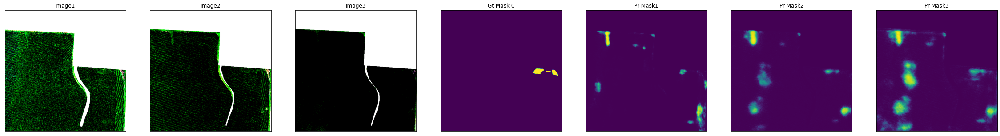

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


KRCZYQMUT


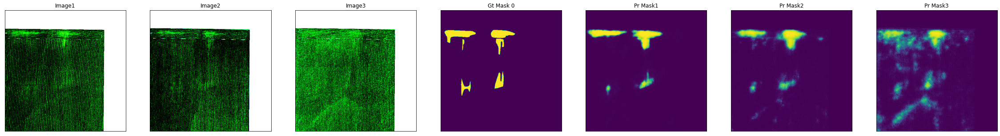

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


P6Z1D4II6


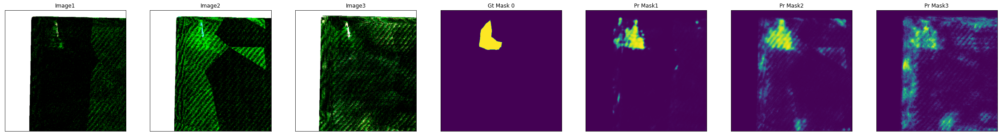

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


34VURFGJY


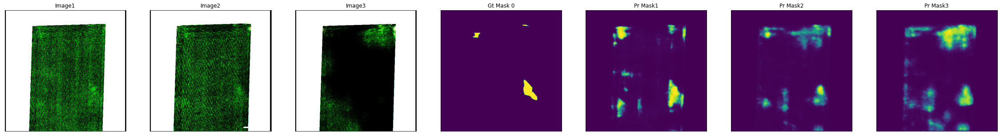

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


W3JYY6WMI


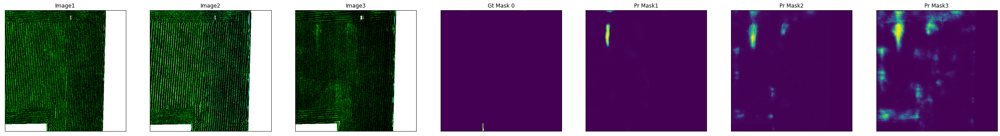

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1GYFAWLYU


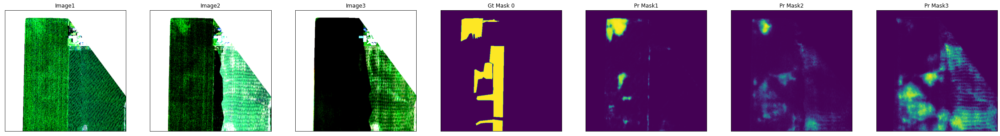

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


P17EGB63M


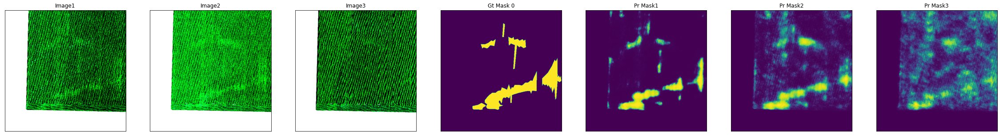

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


WZ2ECYMQT


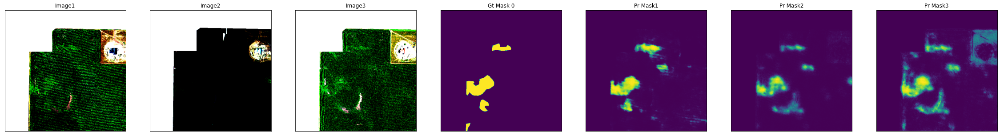

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


FJFFLYRLD


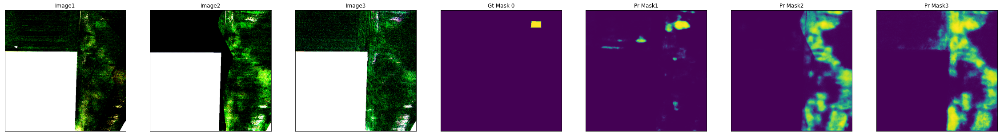

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


AMBEDAYEG


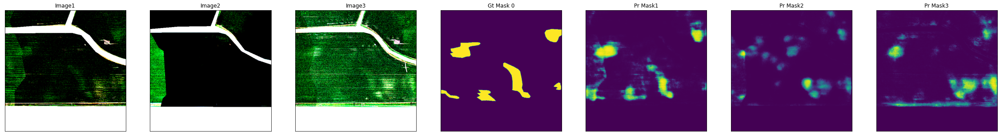

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


ABFZ34386


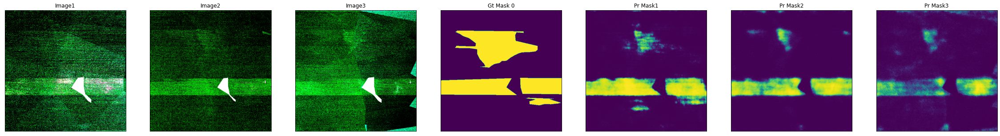

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


U2AVGC8PH


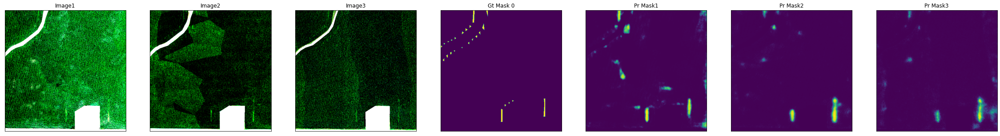

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


B1HX364VH


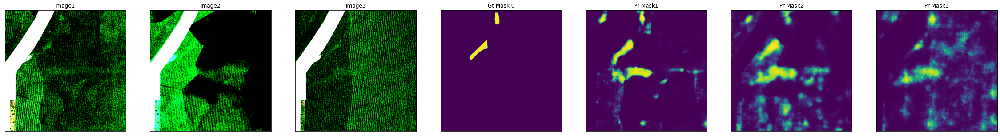

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


XLV9P2UZC


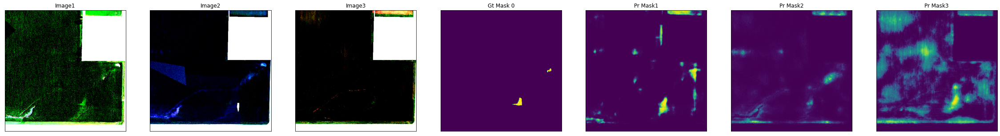

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3W3U46A4H


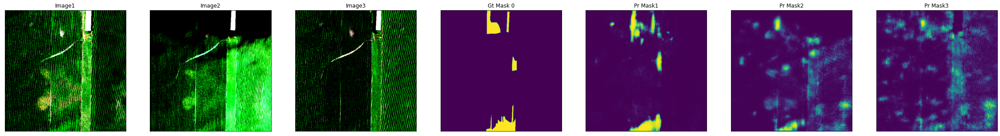

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


687MGJ32E


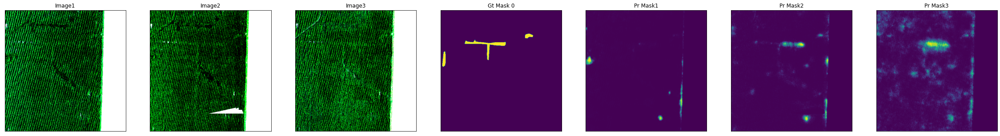

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


KV8M4ZRU7


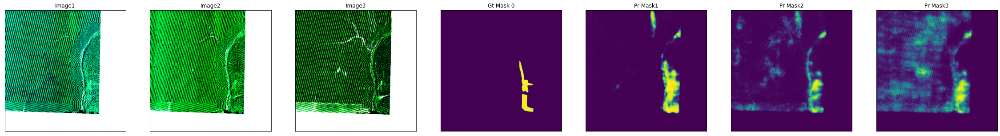

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


CIXWJDV9J


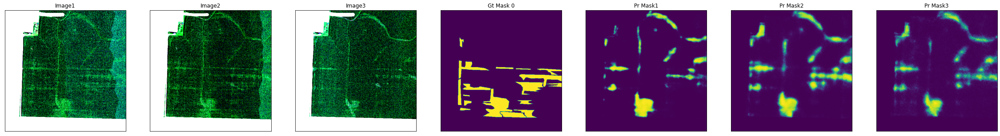

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


WAII8IL3P


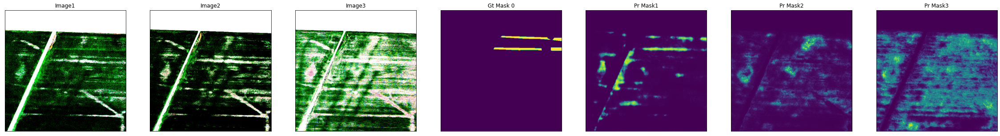

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


KRTJ6MC17


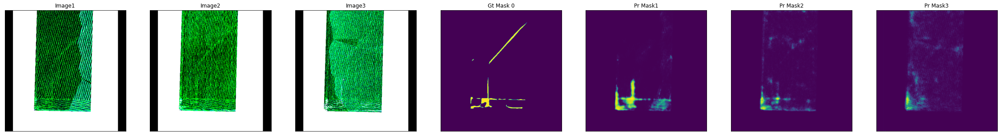

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Q61ULEBRW


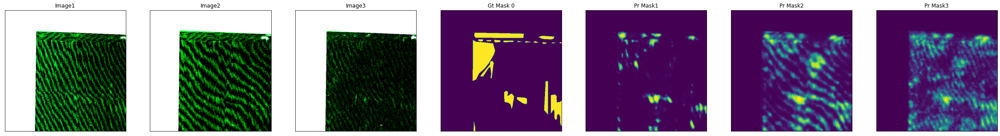

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


B3TXLETPY


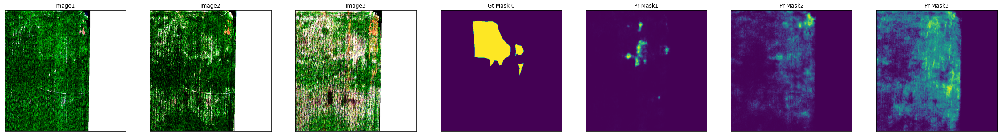

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


B43EY2AUG


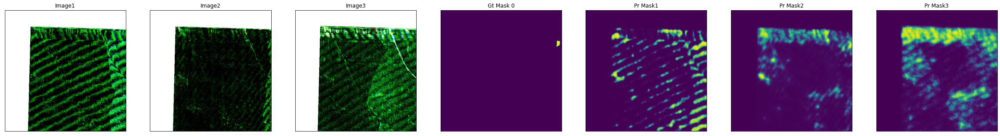

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


WYNM7ZW32


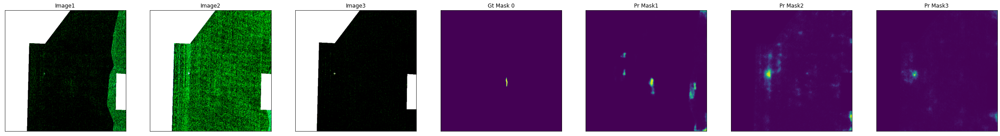

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


ALD9TECXR


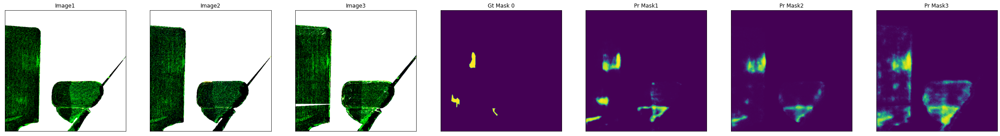

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8MA4DX1P2


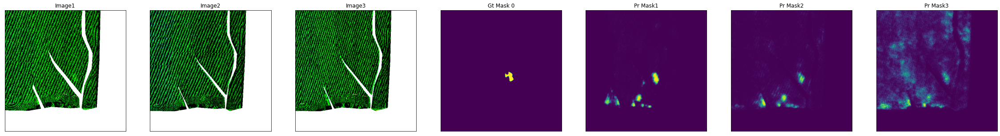

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Y7YQ33CTY


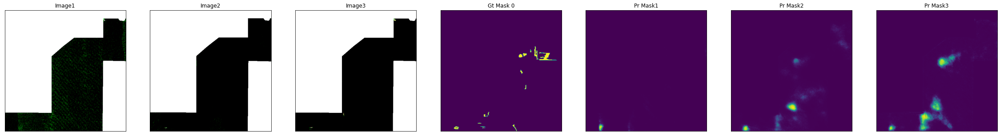

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4VIHRPT3I


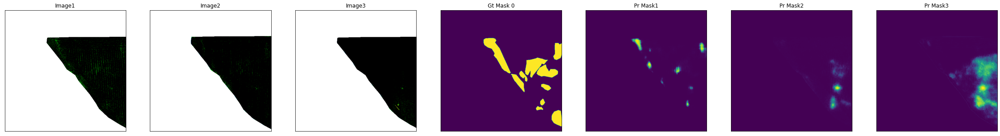

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


YHYHX96T1


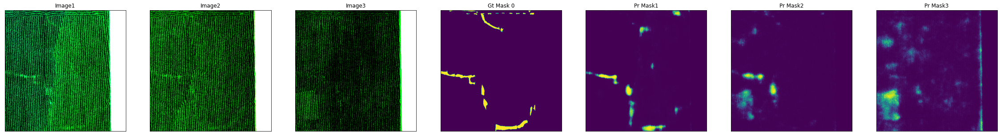

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


MFN6IXPDM


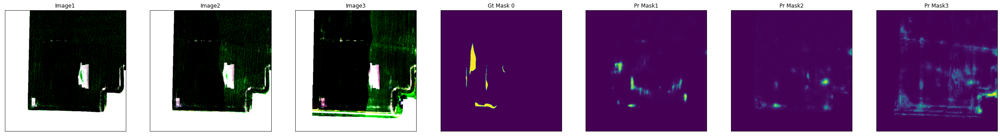

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


JK4HGU4KN


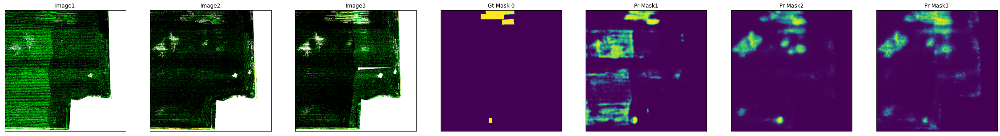

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


B6ALDBGLM


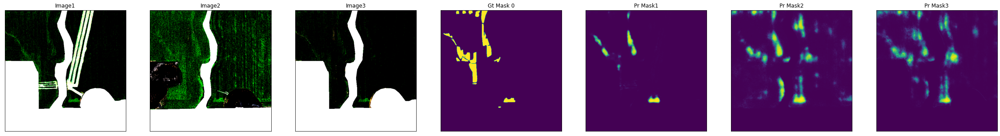

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


NBP4IYV8M


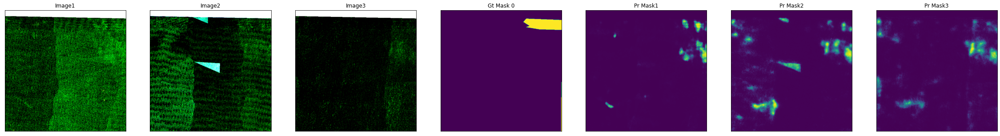

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


6C1YIB7VX


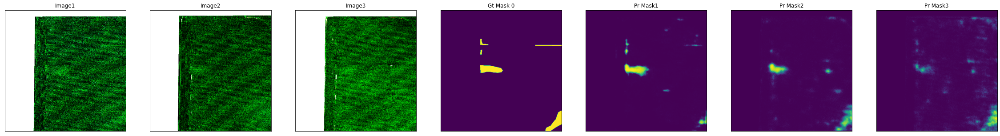

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


LHDRIN8WD


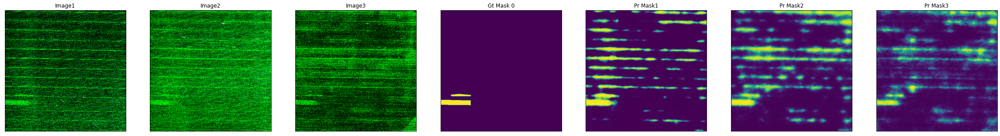

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


RFLUZD7GY


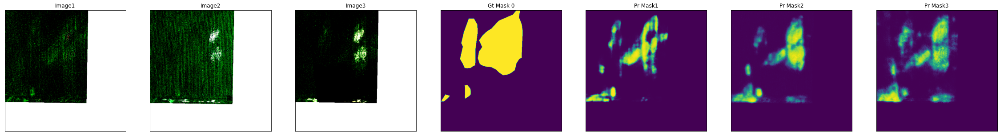

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


KMC7HYAHH


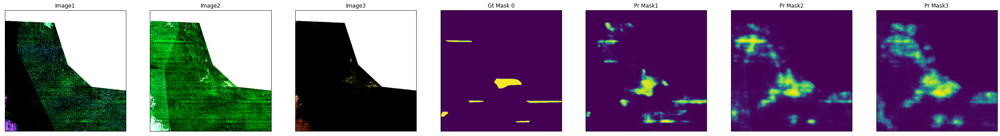

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


DAVXZGDJZ


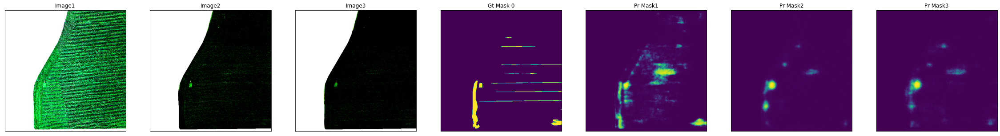

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EF6DZ8NHE


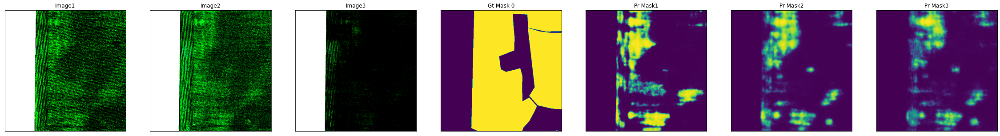

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


FJAWC7E3V


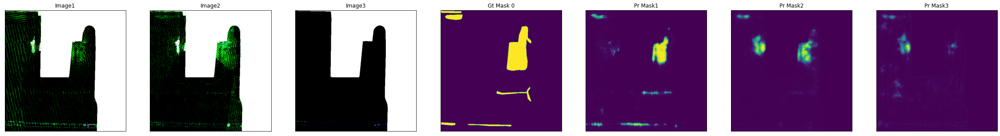

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4DXNTK2PD


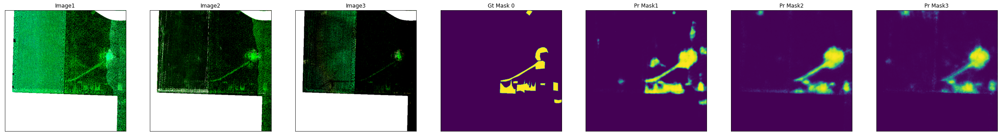

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


CRAL81IM8


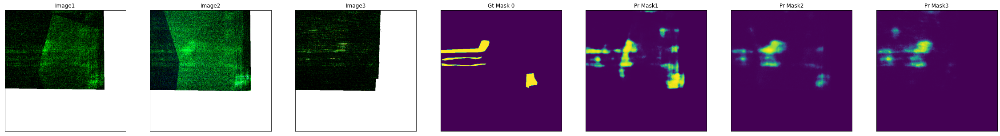

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EVYHXD6LV


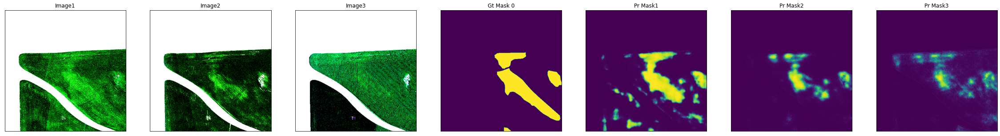

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


CELNH7QIU


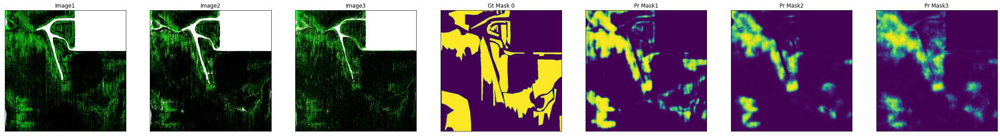

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8FVFFTB34


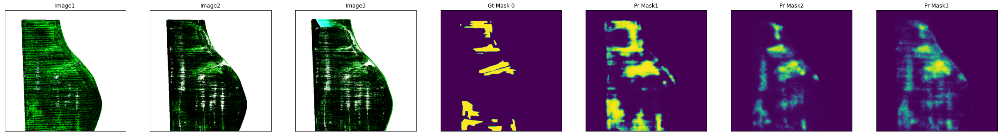

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1KJJ2WXU6


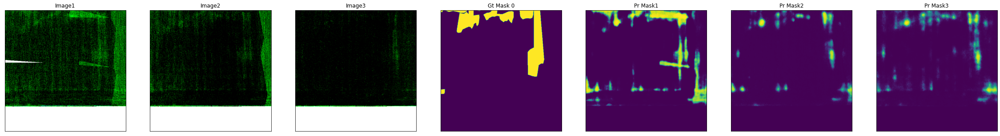

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


TI1EHCARM


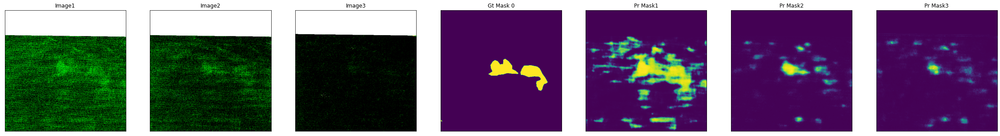

In [9]:

    
sp =HOME_DIR+'Dataset/predictions/'+BACK_BONE+'_batch_'+str(BATCH_SIZE)+'_epoch_'+str(EPOCHS)+'_3_time_steps_3_3_channel_concat'+'/'
n = 47
ids = np.random.choice(np.arange(len(test_dataset)), size=n)

for i in range(0,47):
    
    image1, image2, image3,gt_mask, boundary_mask,flight_code = test_dataset[i]
    #image = np.concatenate((image1, image2, image3), axis = 2)
    image1 = np.expand_dims(image1, axis=0)
    image2 = np.expand_dims(image2, axis=0)
    image3 = np.expand_dims(image3, axis=0)
    pr_mask3,pr_mask2, pr_mask1 = model.predict([image1,image2,image3])
    print(flight_code)
    visualize(
        save_status = False,
        save_path = sp,
        flight_code = flight_code,
        image1 = image1.squeeze(),
        image2 = image2.squeeze(),
        image3 = image3.squeeze(),
        #image_0=denormalize(image.squeeze()),
        gt_mask_0=gt_mask[...,0].squeeze(),
        pr_mask1=pr_mask1[...,0].squeeze(),
        pr_mask2=pr_mask2[...,0].squeeze(),
        pr_mask3=pr_mask3[...,0].squeeze(),
    ) 
        